In [20]:
from osgeo import gdal
import os
import rasterio
from rasterio.plot import show
from glob import glob
from matplotlib import pyplot as plt
from sentinelhub.aws.request import download_safe_format
from sentinelhub import SHConfig
from dotenv import load_dotenv
import zipfile
import shutil
import osgeo_utils.gdal_merge
import requests

Method to display TIFF image in rgb color and with NIR highlight

In [21]:
def display_tif(tif_path: str, title: str) -> None:
    try:
        with rasterio.open(tif_path) as df:
            plt.figure(figsize=(10, 12))
            image = df.read([1, 2, 3, 4])
            show(image[[0, 1, 2]], adjust=True, title=title + " in RGB color")    
            plt.figure(figsize=(10, 12))
            show(image[[3, 0, 1]], adjust=True, title=title + " with NIR highlight")   
    except Exception as e:
        print( f"Failed to open tif file: {e}\n")

Initializing working directories, bands for resolutions, polygon coordinates and shape file path

In [22]:
sentinel_aws_dir = "sentinel_aws"
sentinel_cop_dir = "sentinel_cop"
results_dir = "results"

In [23]:
resolution_bands = {
    "10m":['B04','B03','B02','B08'],
    "20m":['B04','B03','B02','B8A'],
    "60m":['B04','B03','B02','B8A']
}
general_bands = []
for key, value in resolution_bands.items():
    for i in range(0, len(value)):
        general_bands.append(f"R{key}/{value[i]}")

polygon = "POLYGON((29.073321247506765 49.845775018245774, 31.986007792928522 49.845775018245774, " \
     "31.986007792928522 51.278667808079206, 29.073321247506765 51.278667808079206, " \
     "29.073321247506765 49.845775018245774))"
shape_path = "lab_7_data\\Kyiv_regions.shp"

Identificators of Sentinel-2 data

In [24]:
ids = ["S2A_MSIL2A_20190821T085601_N0213_R007_T36UUB_20190821T115206", "S2A_MSIL2A_20190821T085601_N0213_R007_T36UUA_20190821T115206"]

In [25]:
load_dotenv()
access = os.getenv("AWS_ACCESS")
secret = os.getenv("AWS_SECRET")


In [26]:
config = SHConfig()
config.aws_access_key_id = access
config.aws_secret_access_key = secret
config.save()

Downloading data from AWS using sentinelhub module

In [27]:
def download_sentinel_zip(ids: list, dir: str) -> None:
    for id in ids:
        try:
            print(f"Loading for {id}...")
            download_safe_format(
                product_id=id,
                folder=dir,
                bands=general_bands,
                redownload=False
            )
            print(f"{id} successfully loaded.")
        except ValueError as e:
            print(f"Wrong params passed.\nError:{e}")
        except Exception as e:
            print(f"Something went wrong during loading for {id}.\nError:{e}")

In [28]:
download_sentinel_zip(ids, sentinel_aws_dir)

Loading for S2A_MSIL2A_20190821T085601_N0213_R007_T36UUB_20190821T115206...
S2A_MSIL2A_20190821T085601_N0213_R007_T36UUB_20190821T115206 successfully loaded.
Loading for S2A_MSIL2A_20190821T085601_N0213_R007_T36UUA_20190821T115206...
S2A_MSIL2A_20190821T085601_N0213_R007_T36UUA_20190821T115206 successfully loaded.


Getting Copernicus access token

In [29]:
copernicus_email = os.getenv("COPERNICUS_EMAIL")
copernicus_password = os.getenv("COPERNICUS_PASSWORD")

In [36]:
def get_access_token(username: str, password: str) -> str:
    data = {
        "client_id": "cdse-public",
        "username": username,
        "password": password,
        "grant_type": "password"
    }

    try:
        r = requests.post(
            "https://identity.dataspace.copernicus.eu/auth/realms/CDSE/protocol/openid-connect/token",
            data=data,
        )
        
        r.raise_for_status()
    except Exception as e:
        print(f"Access token creation failed. Reponse from the server was: {r.json()}")
        return None
    return r.json()["access_token"]

In [37]:
token = get_access_token(copernicus_email, copernicus_password)
cop_ids = ["S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823", "S2A_MSIL2A_20190821T085601_N0500_R007_T36UUA_20230719T201823"]

Downloading data from Copernicus using access token

In [38]:
product_ids = ["79295d50-882e-43d7-b1df-6507d38e9b25", "ff2d5dc6-9b46-47fa-8aa2-aa7a53a77ef0"]
urls = [f"https://download.dataspace.copernicus.eu/odata/v1/Products({product_id})/$value" for product_id in product_ids]

headers = {
    "Authorization": f"Bearer {token}"
}

os.makedirs(sentinel_cop_dir, exist_ok=True)

for index, url in enumerate(urls):
    response = requests.get(url, headers=headers, allow_redirects=True)
    if response.status_code == 200:
        file_path = os.path.join(sentinel_cop_dir, f"{cop_ids[index]}.zip")
        with open(file_path, "wb") as f:
            f.write(response.content)
        print(f"Saved: {file_path}")
        id_dir = os.path.join(sentinel_cop_dir, cop_ids[index])
        for res in resolution_bands: 
            os.makedirs(os.path.join(id_dir, res),exist_ok=True)
        with zipfile.ZipFile(file_path, 'r') as zip_data:
            for filename in zip_data.namelist():
                for res in resolution_bands:
                    if res in filename:
                        for band in resolution_bands[res]:
                            if band in filename:
                                source = zip_data.open(filename)
                                target = open(os.path.join(os.path.join(id_dir, res), os.path.basename(filename)), "wb")
                                with source, target:
                                    shutil.copyfileobj(source, target)
                                print(f"Successfuly extracted jp2 file from {cop_ids[index]}.zip: band - {band}, resolution - {res}")
    else:
        print(f"Failed to download {url}, status code: {response.status_code}")

Saved: sentinel_cop\S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823.zip
Successfuly extracted jp2 file from S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823.zip: band - B02, resolution - 10m
Successfuly extracted jp2 file from S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823.zip: band - B03, resolution - 10m
Successfuly extracted jp2 file from S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823.zip: band - B04, resolution - 10m
Successfuly extracted jp2 file from S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823.zip: band - B08, resolution - 10m
Successfuly extracted jp2 file from S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823.zip: band - B02, resolution - 20m
Successfuly extracted jp2 file from S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823.zip: band - B03, resolution - 20m
Successfuly extracted jp2 file from S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823.zip: band - B04, resolution - 20

Method to concatenate bands of image for every resolution

In [ ]:
def concatenate_bands(bands: list, bands_dir: str, output_dir: str) -> str:
    output_path = os.path.join(output_dir, "concatenated.TIF")
    cmd = ["","-separate","-o", output_path]
    os.makedirs(output_dir, exist_ok=True)
    for band in bands:
        band_files = glob(os.path.join(bands_dir, f"*_{band}_*"))
        if band_files:
            cmd.append(band_files[0])
        else:
            print(f"Failed to find band {band}. Concatenation failed.")
            return None
    try:
        osgeo_utils.gdal_merge.gdal_merge(cmd)
        return output_path
    except Exception as e:
        print(f"Failed to concatenate:\n{e}")
        return None

Concatenating for S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823...
Concatenating for 10m resolution...
Concatenation was successful.


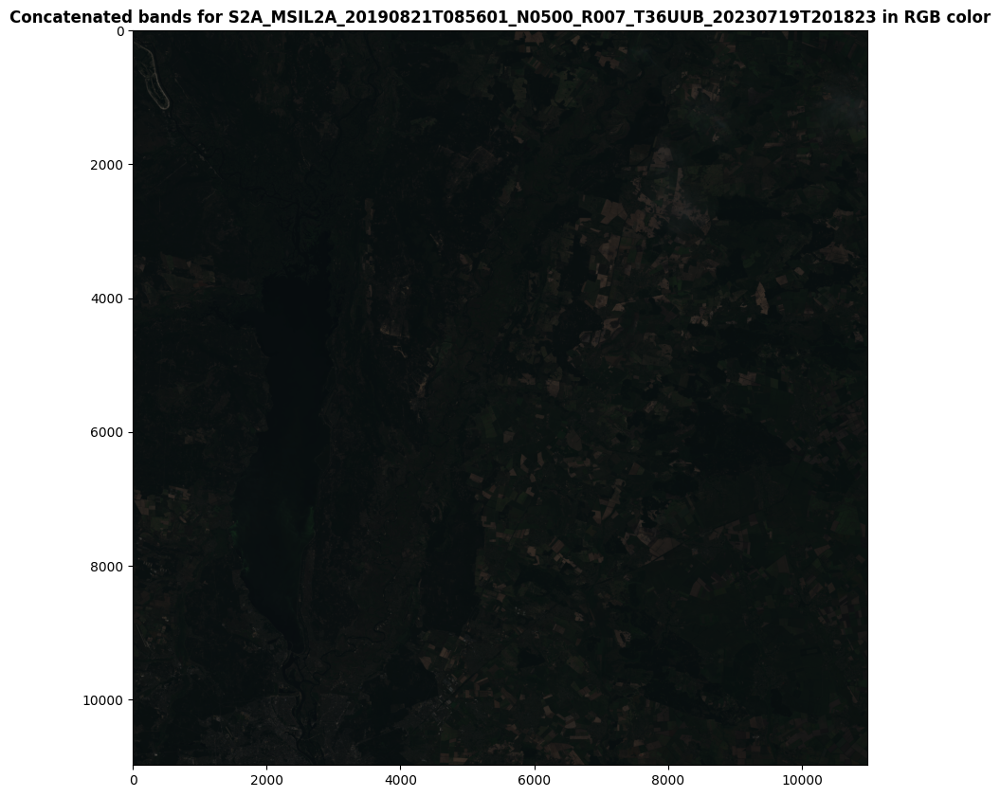

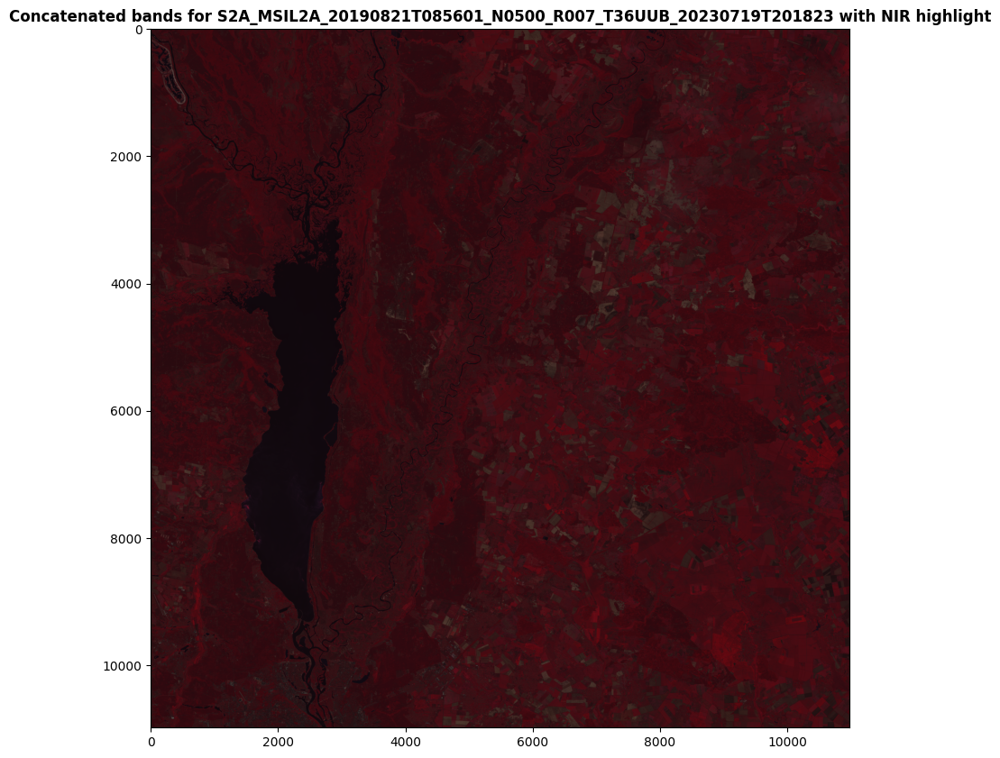

Concatenating for 20m resolution...
Concatenation was successful.


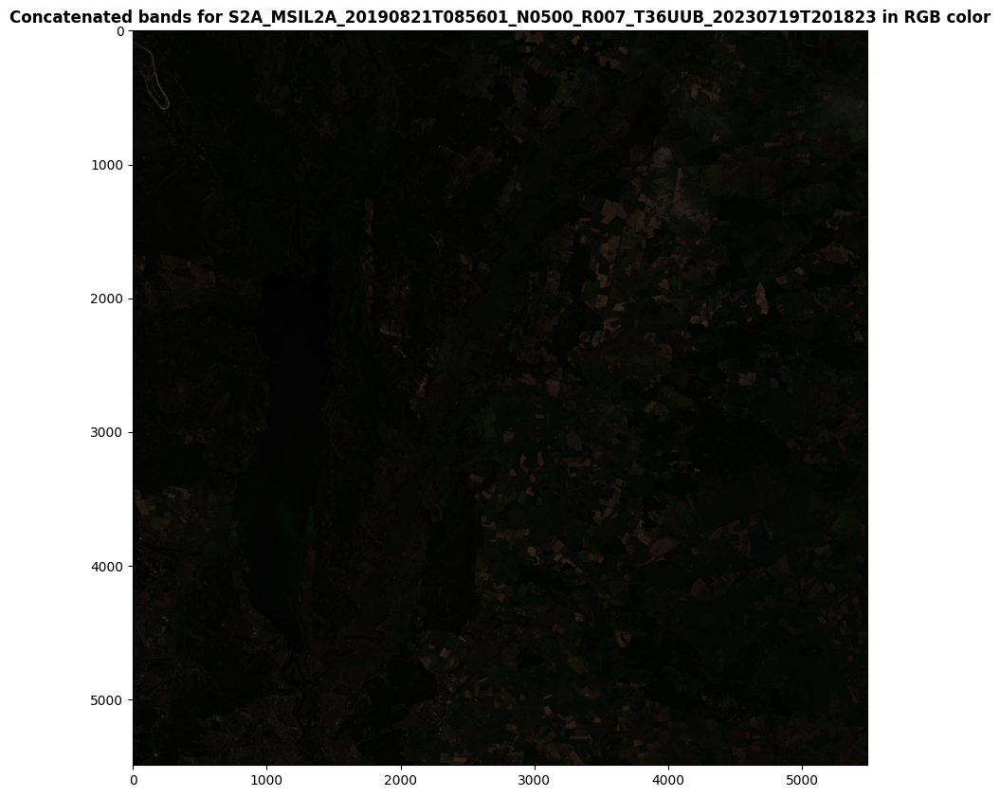

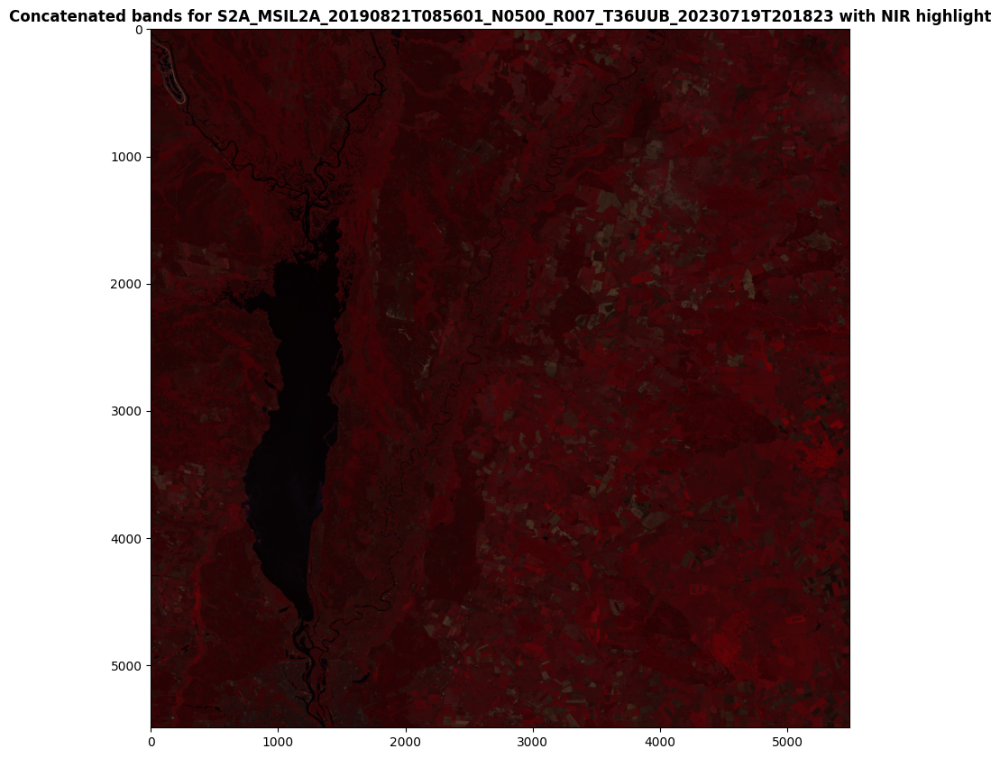

Concatenating for 60m resolution...
Concatenation was successful.


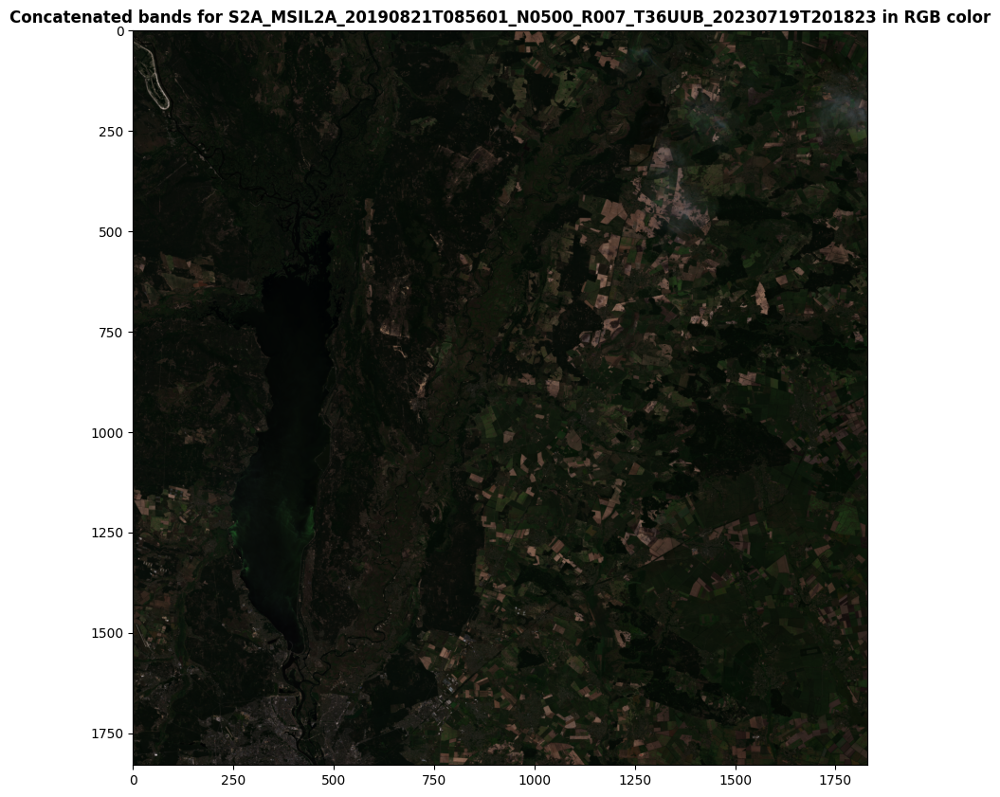

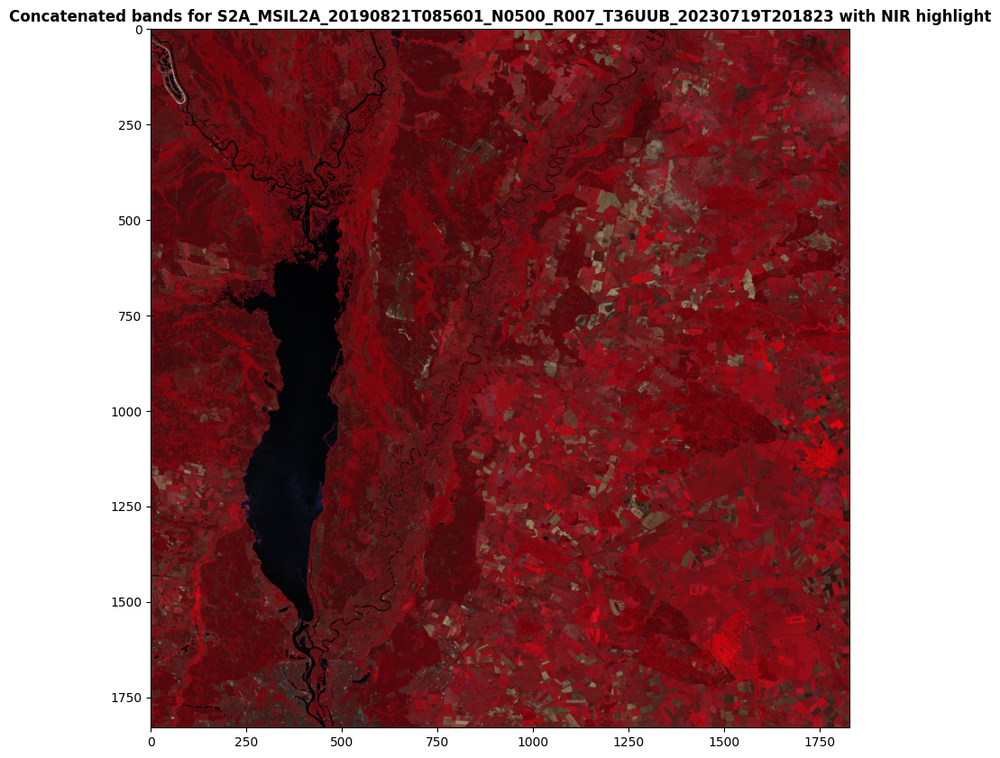

Concatenating for S2A_MSIL2A_20190821T085601_N0500_R007_T36UUA_20230719T201823...
Concatenating for 10m resolution...
Concatenation was successful.


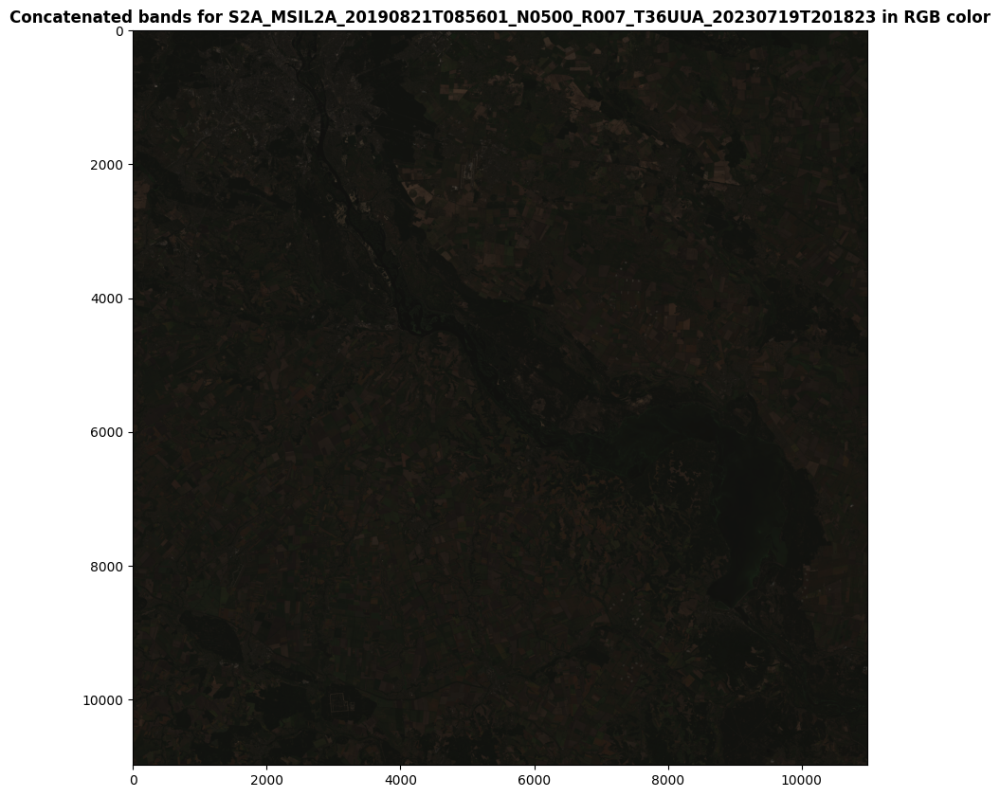

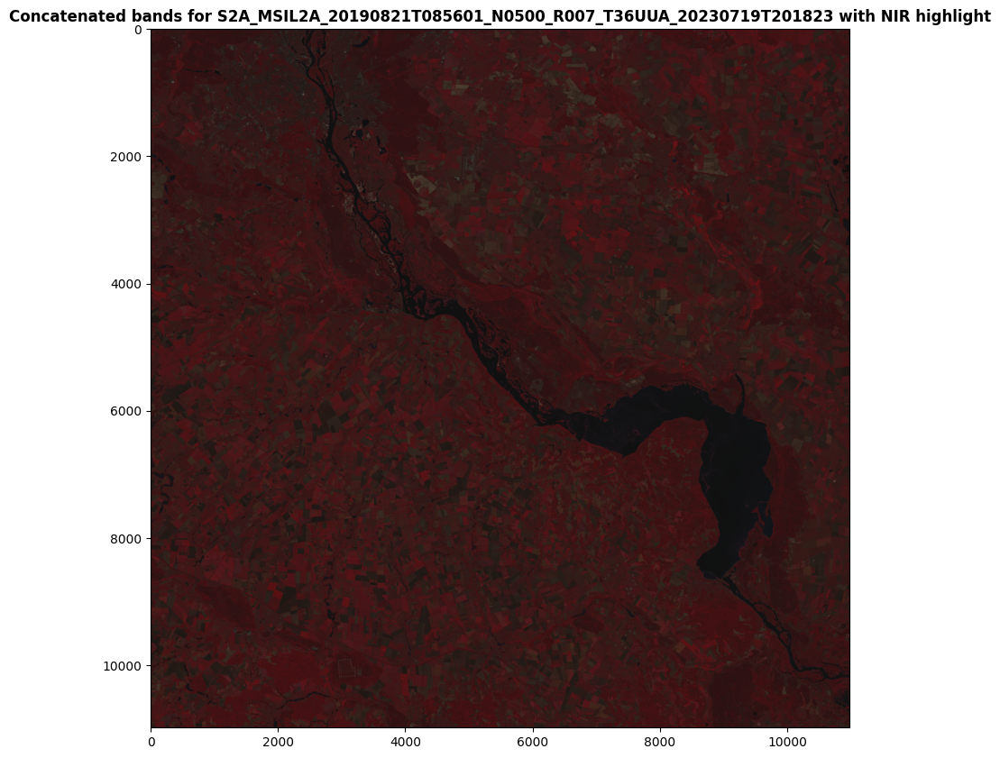

Concatenating for 20m resolution...
Concatenation was successful.


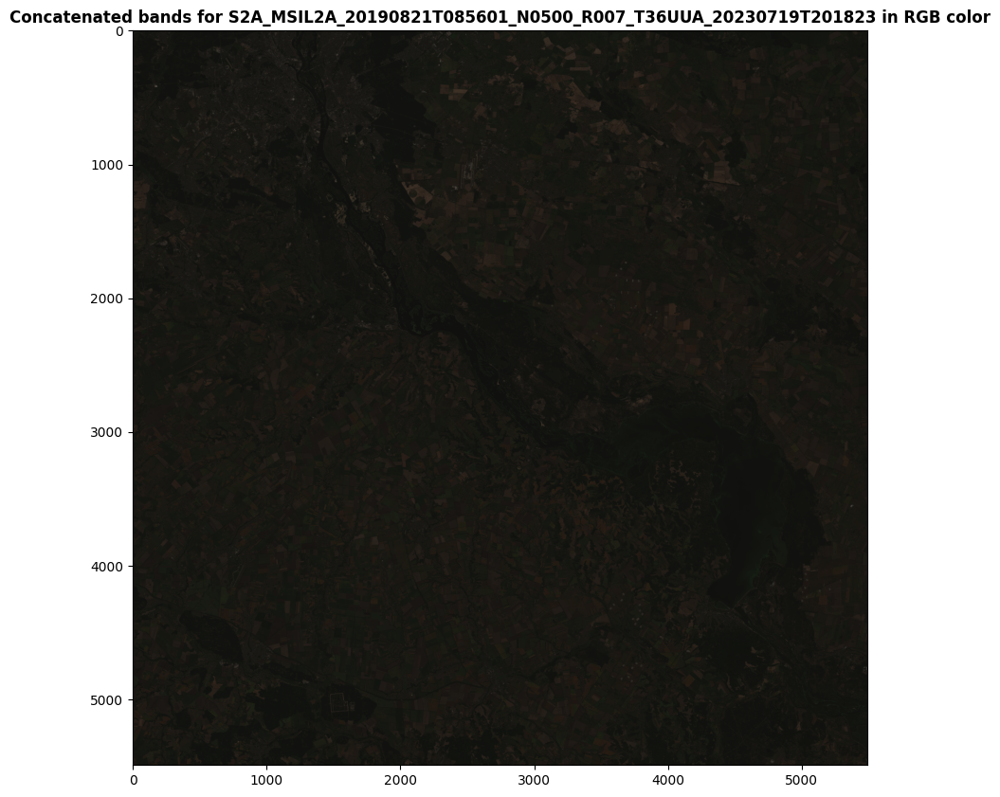

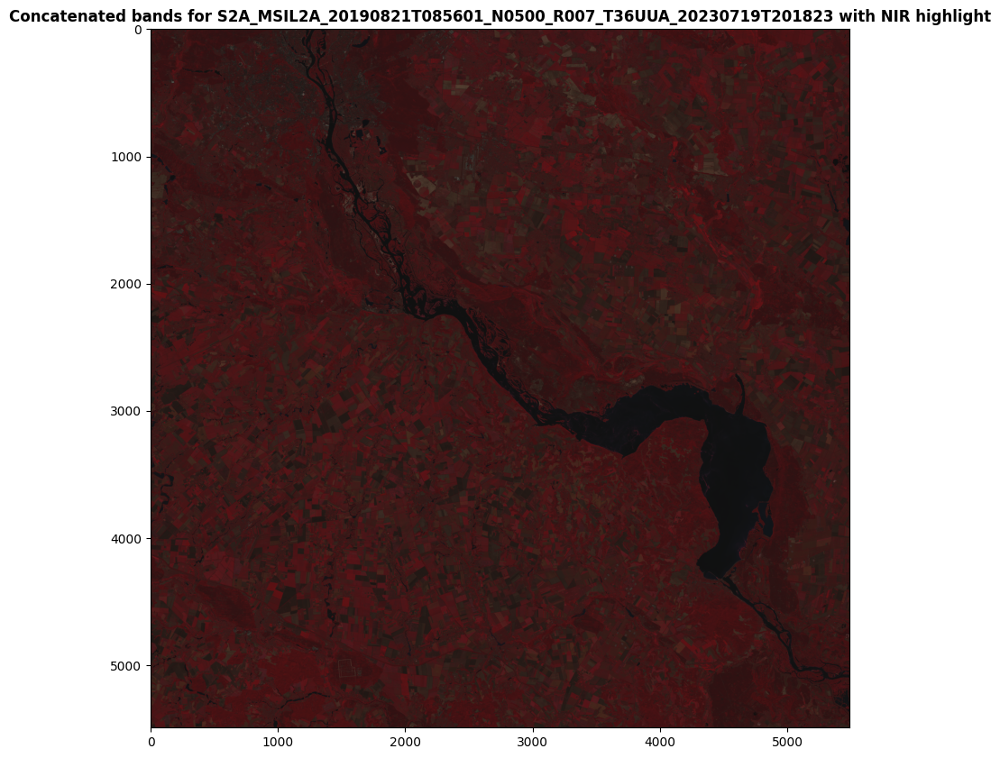

Concatenating for 60m resolution...
Concatenation was successful.


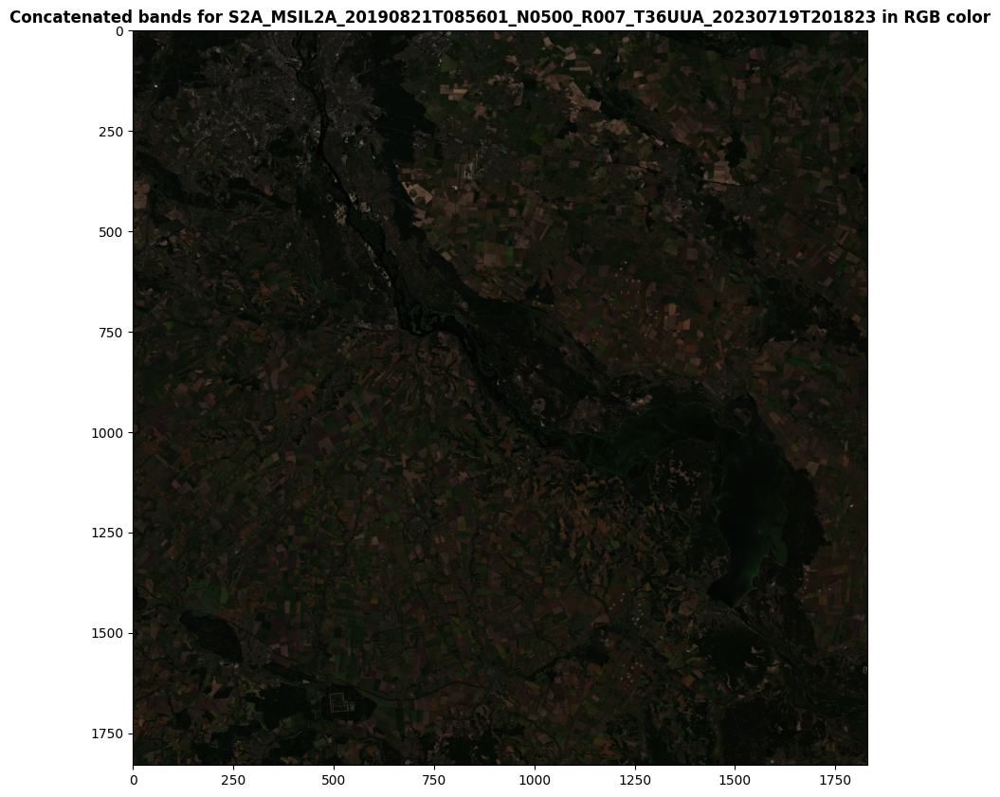

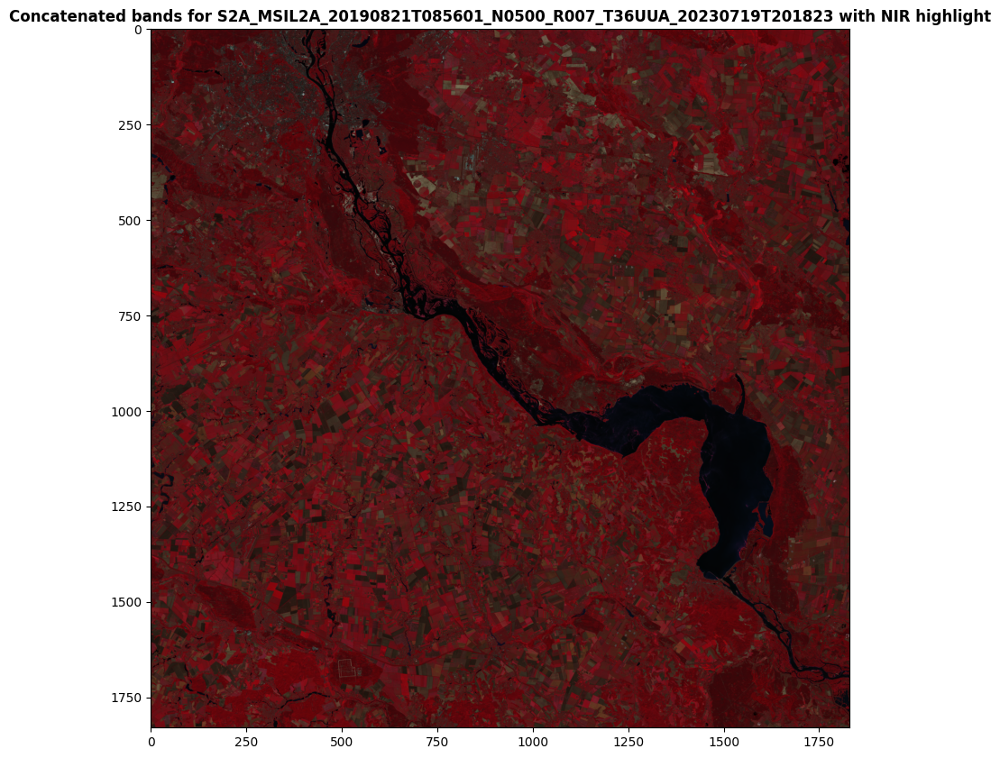

In [ ]:
os.makedirs(results_dir, exist_ok=True)
for id in cop_ids:
    print(f"Concatenating for {id}...")
    id_dir = os.path.join(sentinel_cop_dir, id)
    id_output_dir = os.path.join(results_dir, id)
    os.makedirs(id_output_dir, exist_ok=True)
    for res in resolution_bands:
        res_dir = os.path.join(id_dir, res)
        res_output_dir = os.path.join(id_output_dir, res)
        print(f"Concatenating for {res} resolution...")
        output_file = concatenate_bands(resolution_bands[res], res_dir, res_output_dir)
        if output_file: 
            print("Concatenation was successful.")
            display_tif(output_file, f"Concatenated bands for {id}")

Method to reproject every concatenated TIFF image in 4326 projection

In [ ]:
def reproject(input_path: str, projection: str) -> None:
    if not os.path.exists(input_path):
        print(f"Failed to find input file.")
        return None
    try:
        output_path = os.path.join(os.path.dirname(input_path),"reprojected.TIF")
        gdal.Warp(output_path, input_path, options=f"-t_srs {projection}")
        return output_path
    except Exception as e:
        print(f"Failed to reproject {input_path}.\nError: {e}")
        return None

Reprojecting into 4326 for S2A_MSIL2A_20190821T085601_N0500_R007_T36UUB_20230719T201823...
Reprojecting into 4326 for 10m resolution...
Reprojection successfuly finished.


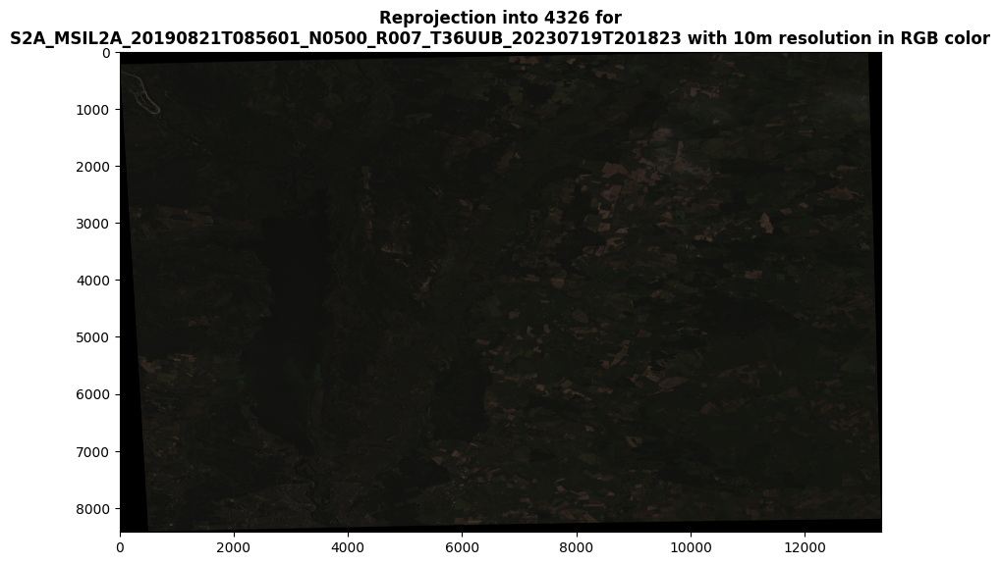

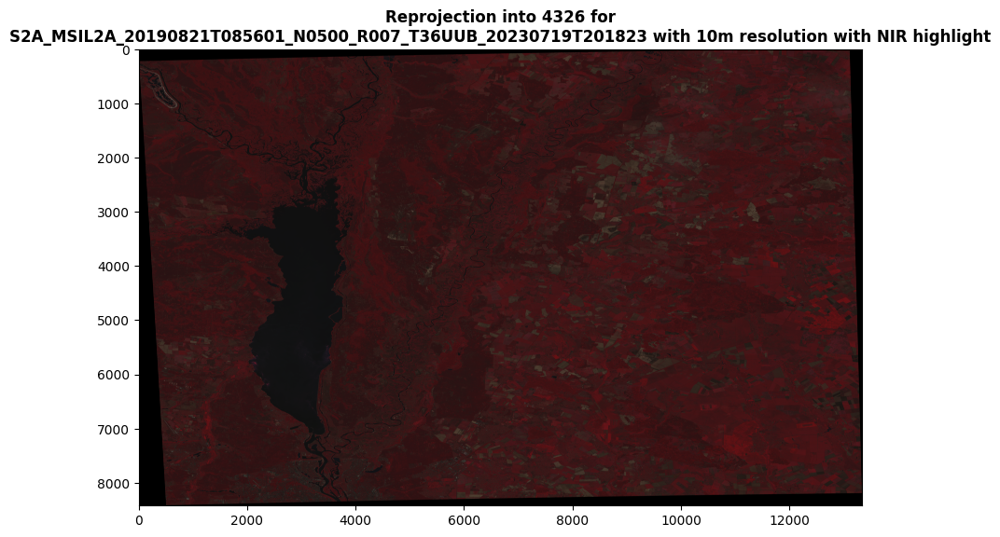

Reprojecting into 4326 for 20m resolution...
Reprojection successfuly finished.


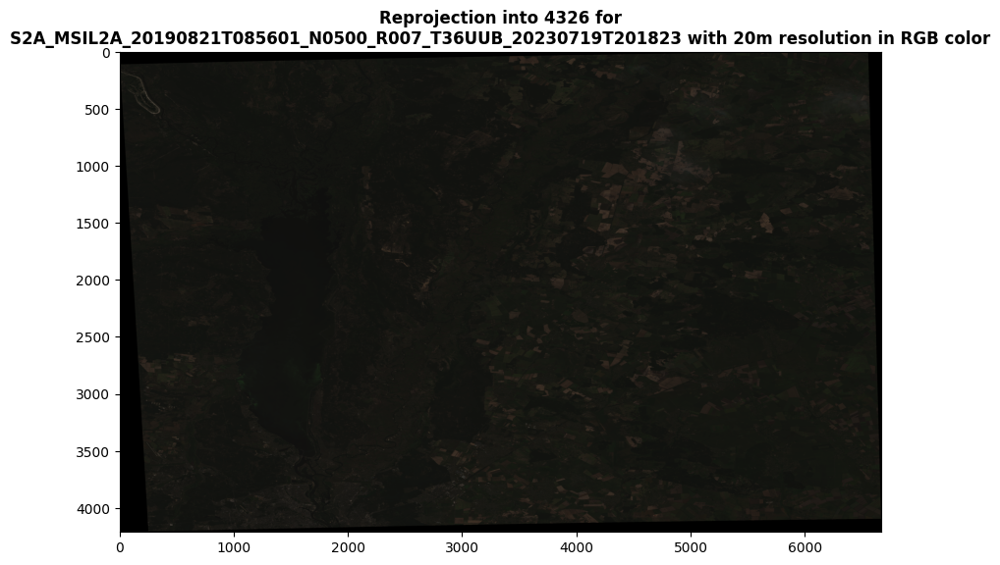

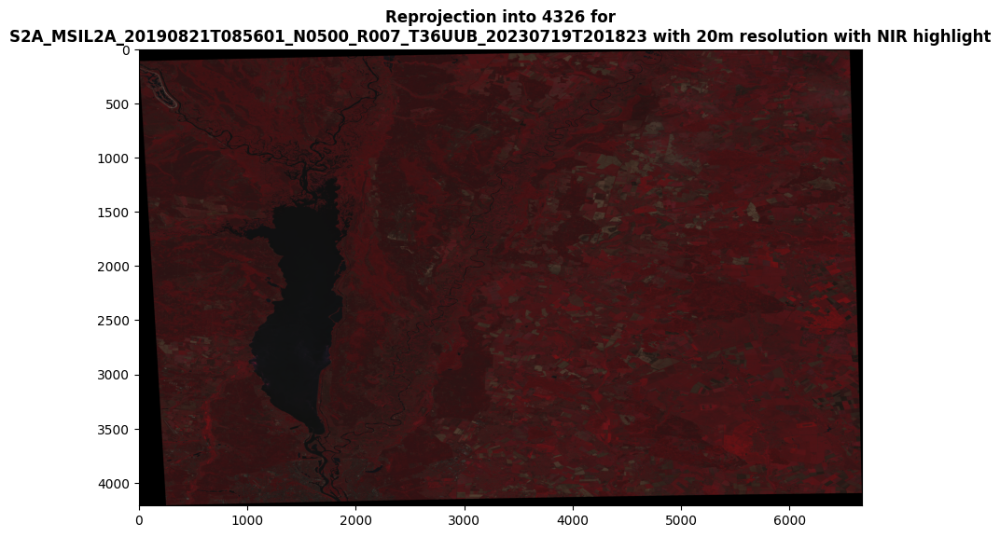

Reprojecting into 4326 for 60m resolution...
Reprojection successfuly finished.


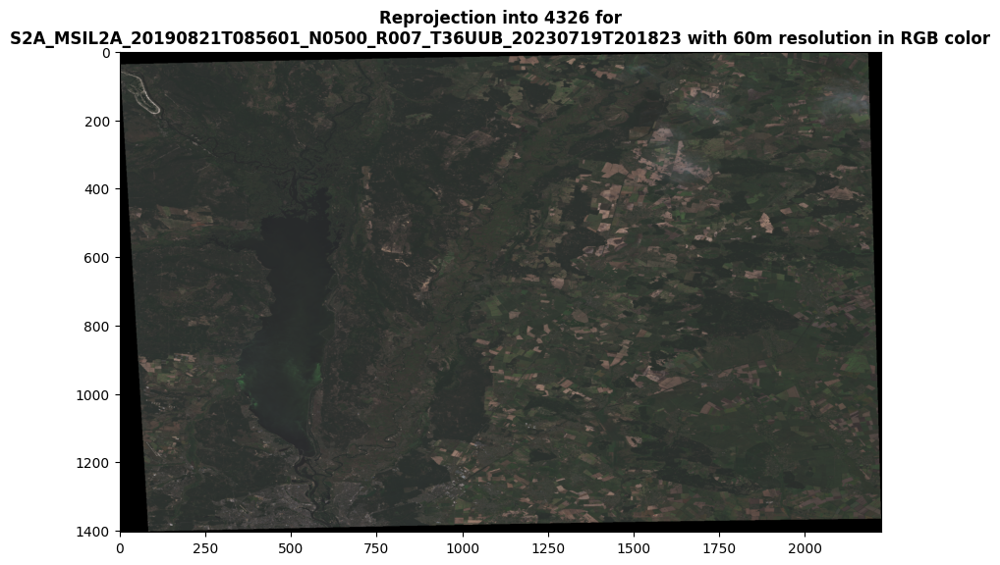

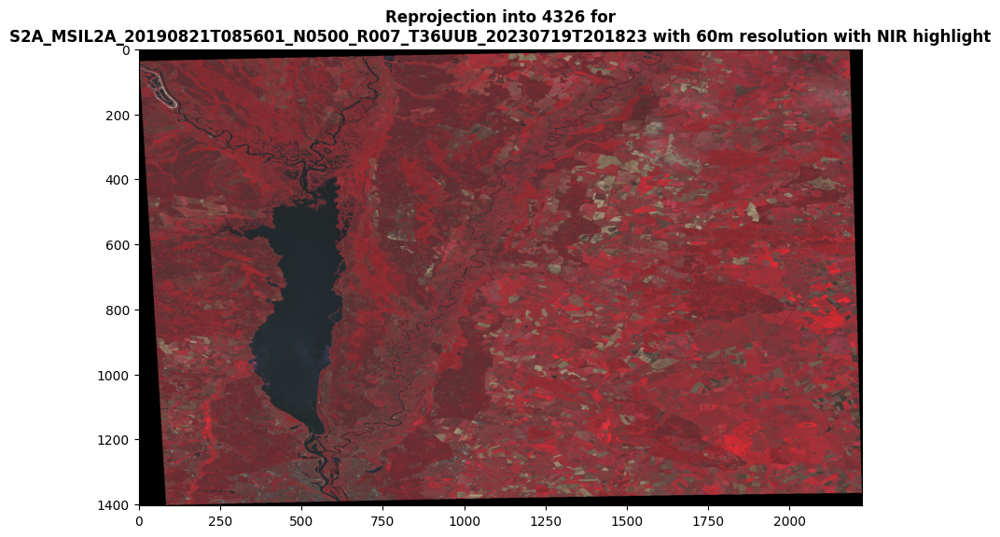

Reprojecting into 4326 for S2A_MSIL2A_20190821T085601_N0500_R007_T36UUA_20230719T201823...
Reprojecting into 4326 for 10m resolution...
Reprojection successfuly finished.


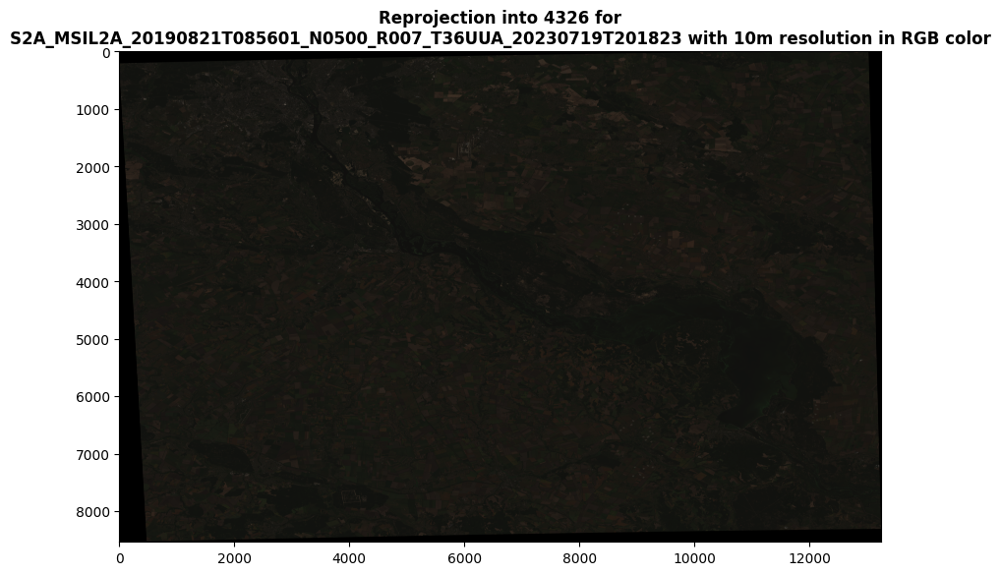

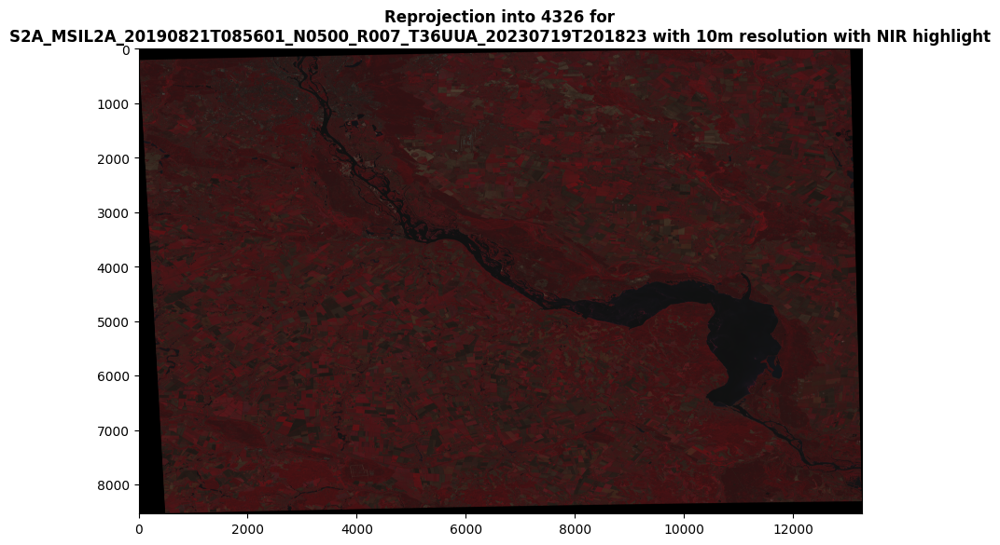

Reprojecting into 4326 for 20m resolution...
Reprojection successfuly finished.


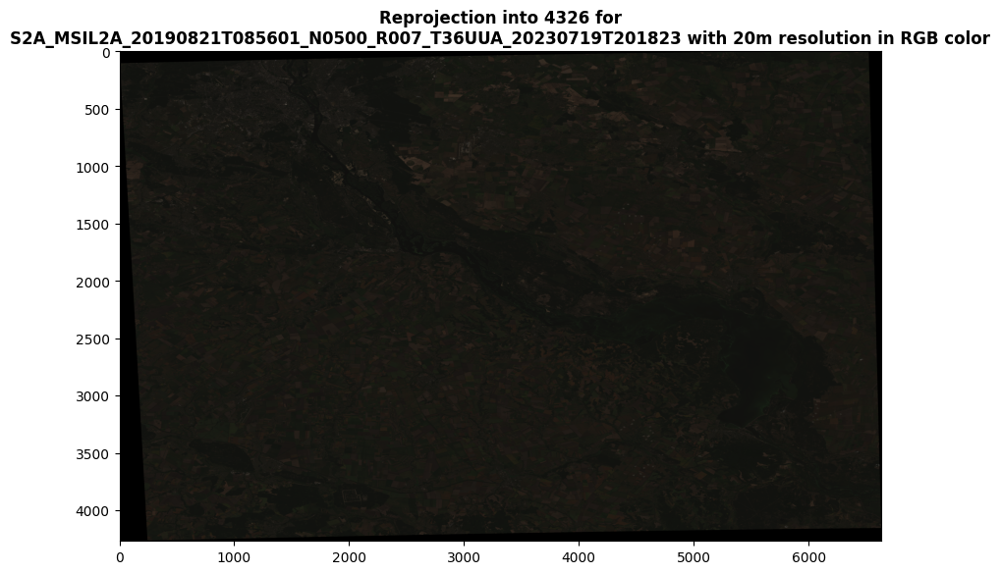

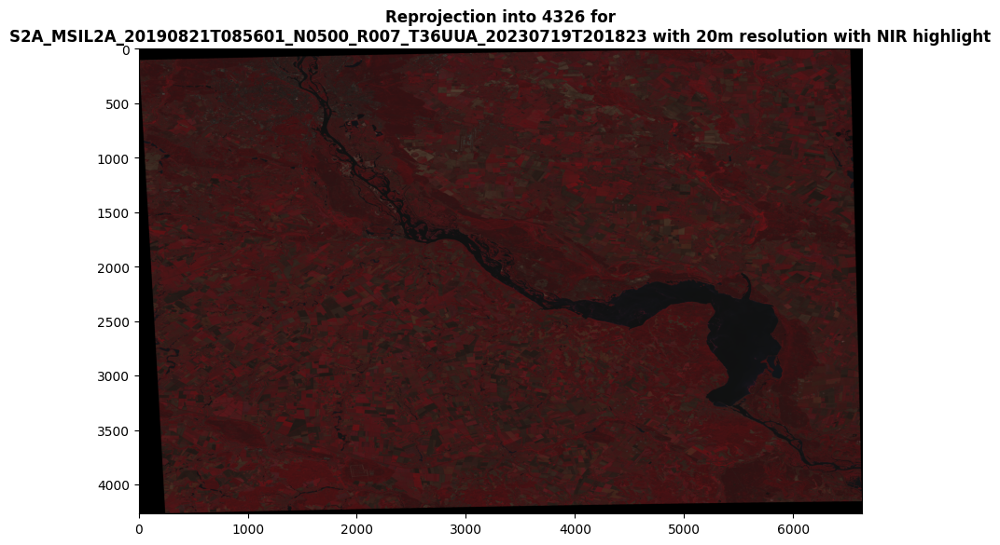

Reprojecting into 4326 for 60m resolution...
Reprojection successfuly finished.


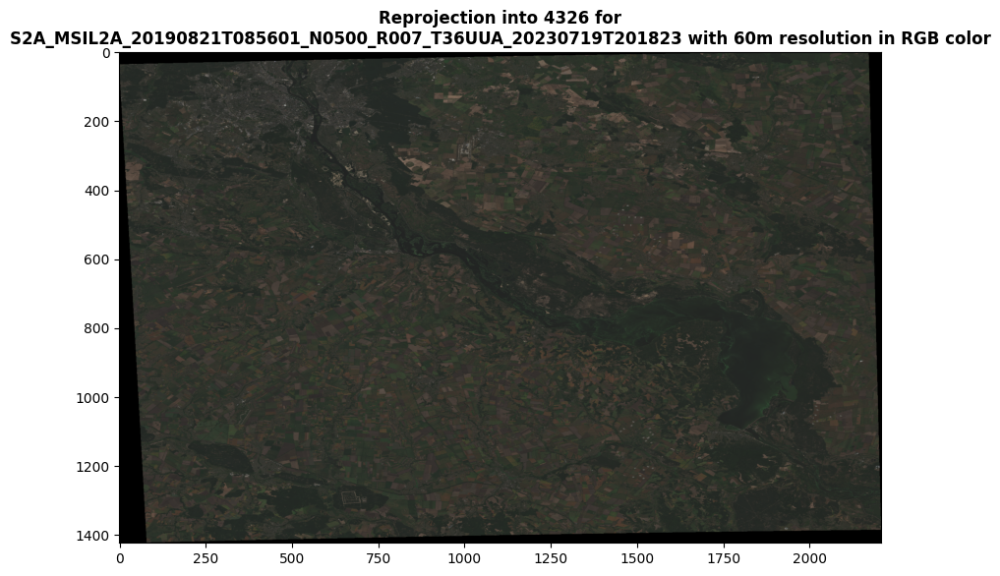

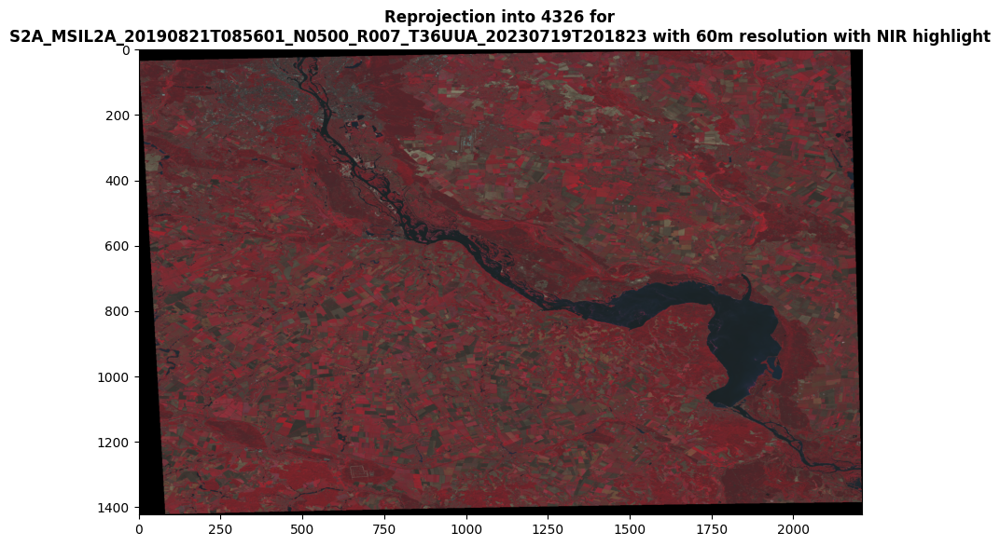

In [ ]:
for id in cop_ids:
    print(f"Reprojecting into 4326 for {id}...")
    id_out_dir = os.path.join(results_dir, id)
    for res in resolution_bands:
        res_out_dir = os.path.join(id_out_dir, res)
        print(f"Reprojecting into 4326 for {res} resolution...")
        input_file = os.path.join(res_out_dir,'concatenated.TIF')
        output_file = reproject(input_file, "EPSG:4326")
        if output_file:
            print("Reprojection successfuly finished.") 
            display_tif(output_file, f"Reprojection into 4326 for\n{id} with {res} resolution")

Method to merge raster images of south and north parts of Kyiv for every resolution

In [39]:
def merge_rasters(raster_file_list: list, output_file: str) -> bool: 
	datasets_list = []
	try:
		for raster in raster_file_list:
			if not os.path.exists(raster):
				print(f"Raster {raster} does not exists.")
				return False
			dataset = gdal.Warp('', raster, format='vrt', dstNodata=0)
			datasets_list.append(dataset)
		vrt = gdal.BuildVRT('', datasets_list, VRTNodata=0, srcNodata=0)
		result = gdal.Translate(output_file, vrt)
	except Exception as e:
		print(f"Failed to merge rasters:\n {e}")
		return False
	return True

Merging reprojected rasters for 10m resolution...
Successfuly merged using gdalwarp


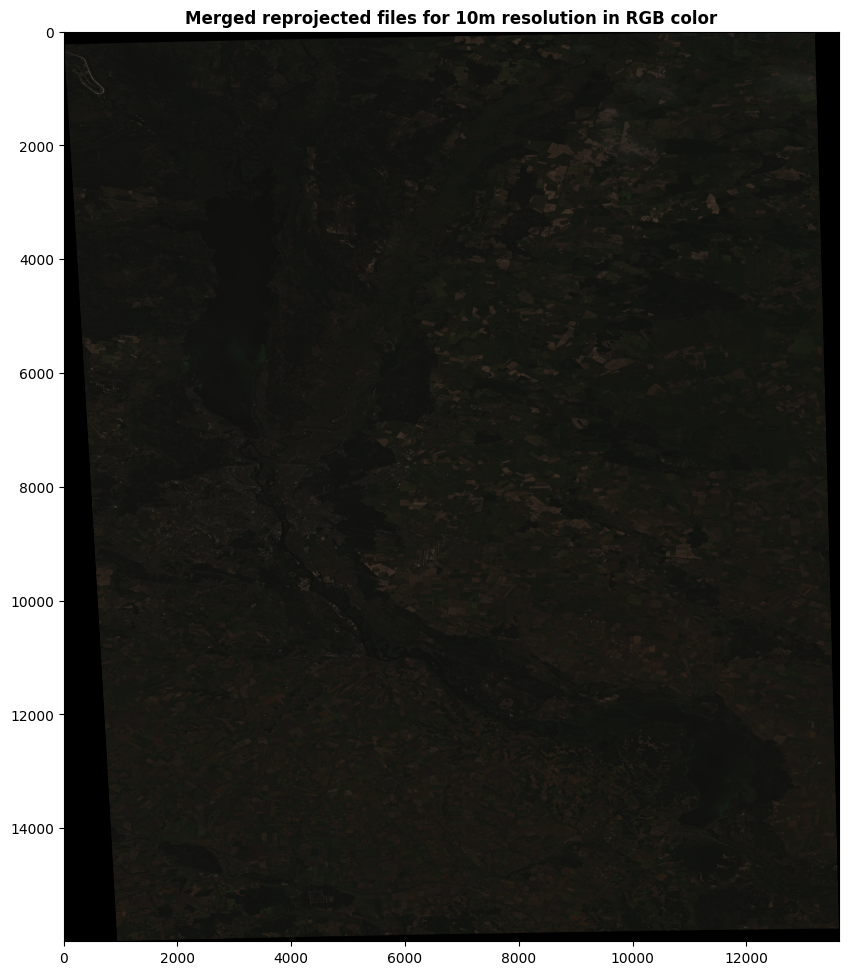

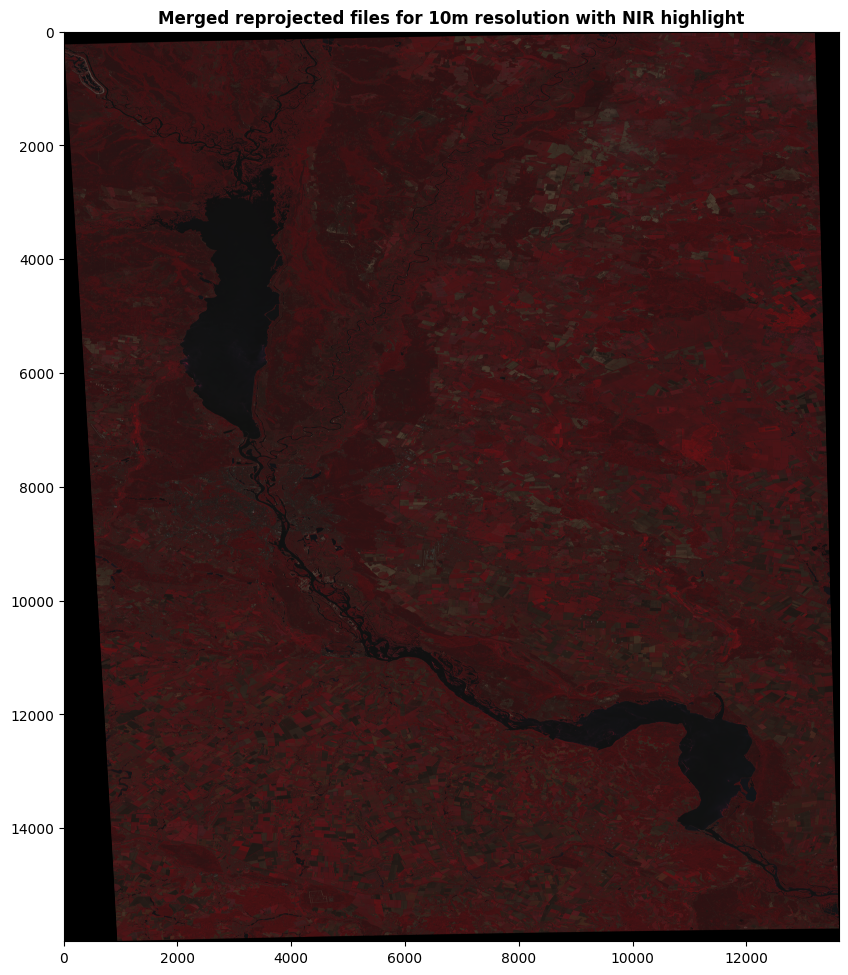

Merging reprojected rasters for 20m resolution...
Successfuly merged using gdalwarp


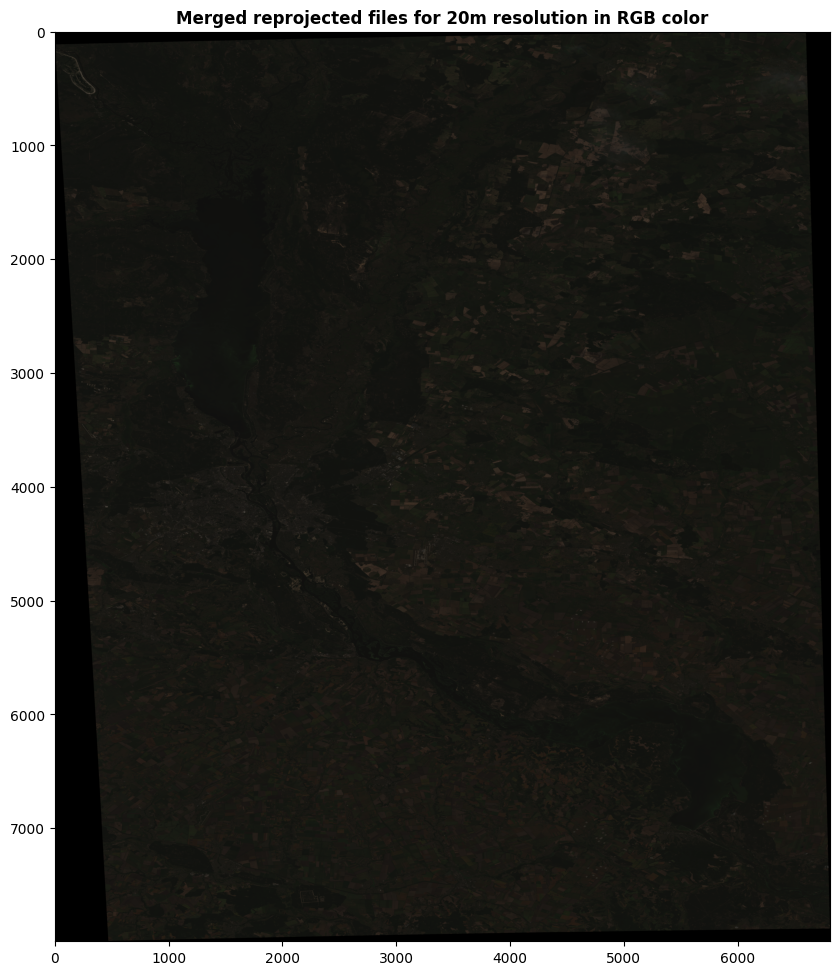

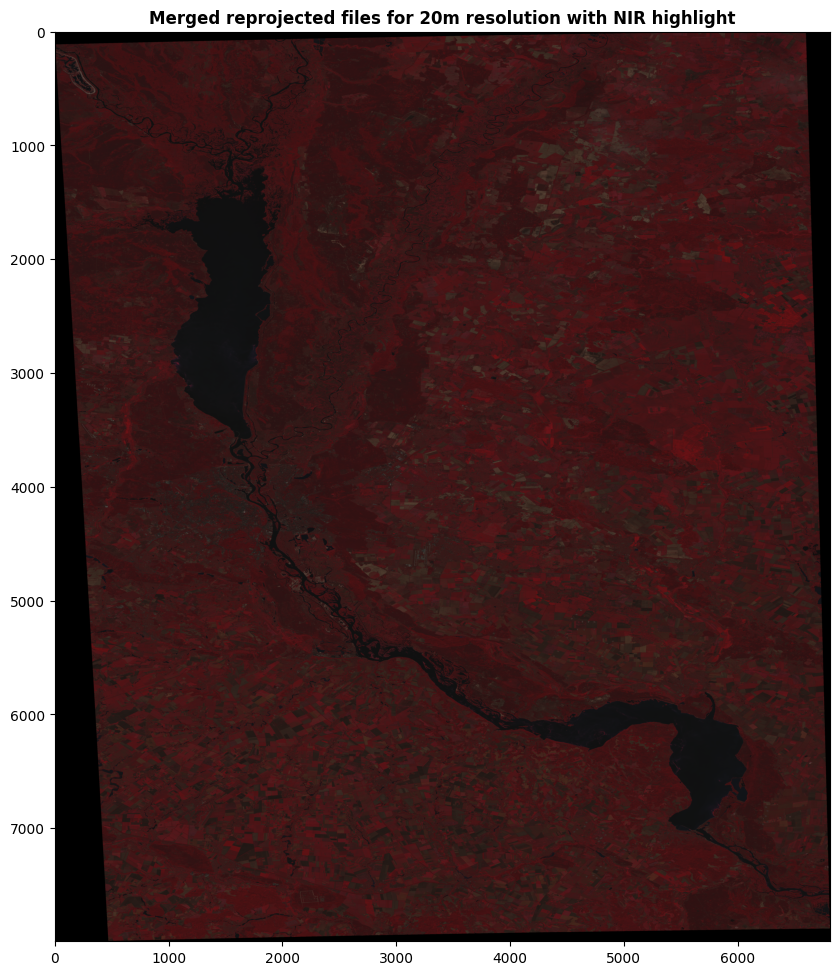

Merging reprojected rasters for 60m resolution...
Successfuly merged using gdalwarp


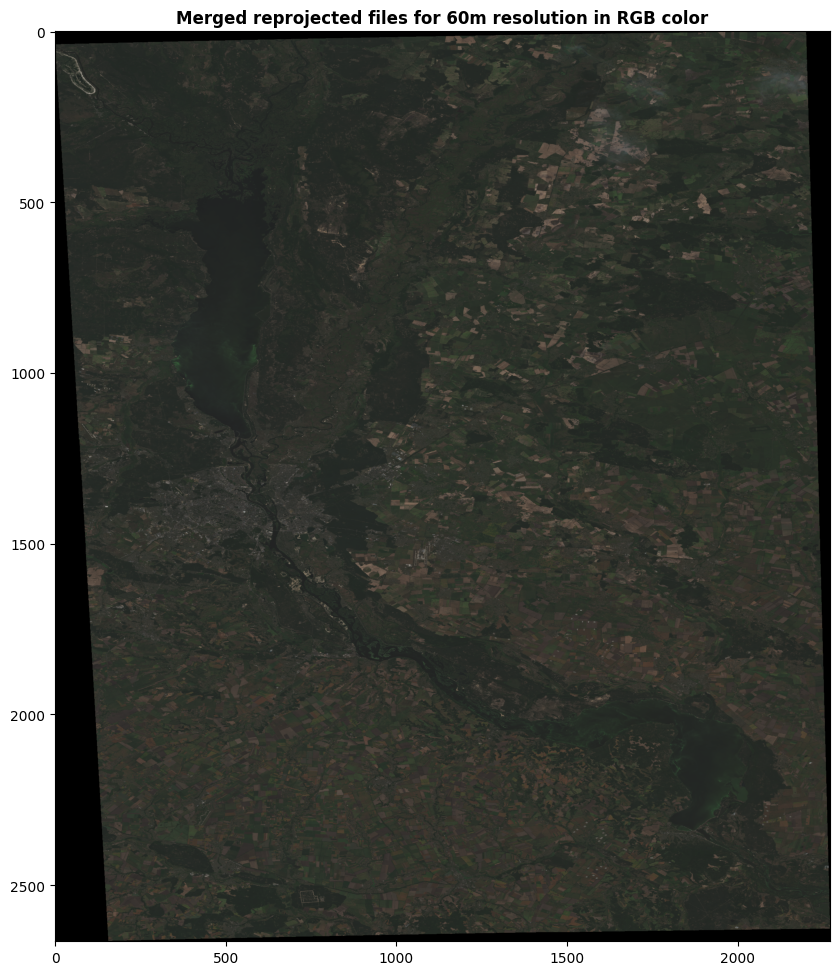

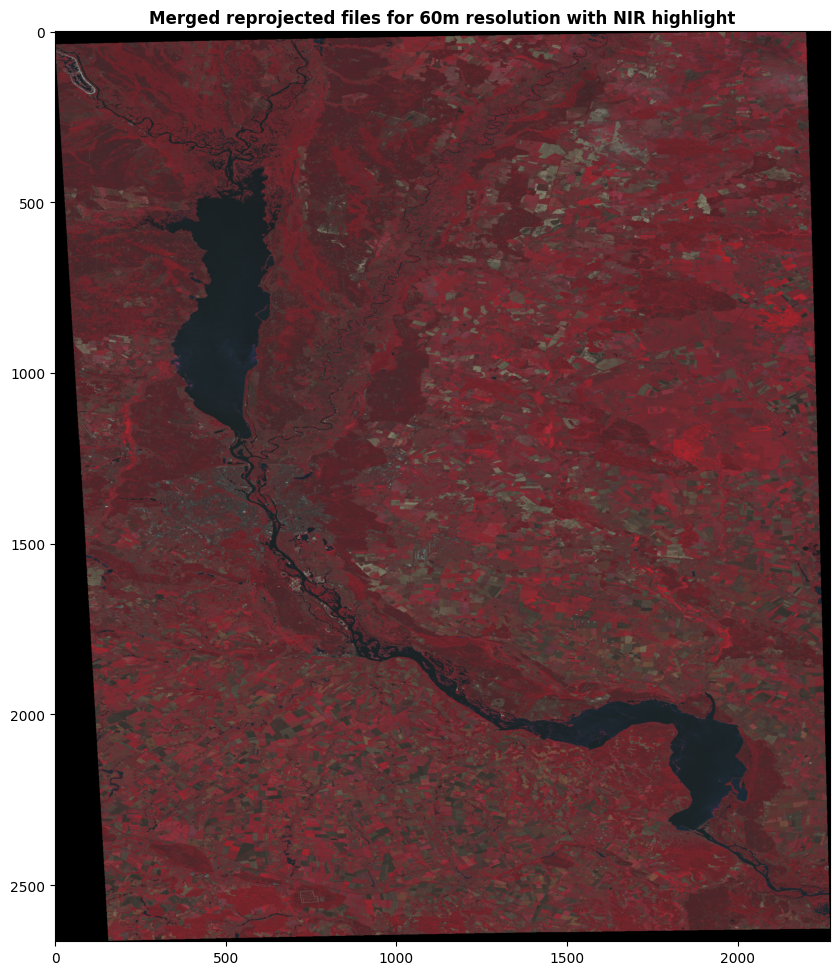

In [40]:
for res in resolution_bands:
    print(f"Merging reprojected rasters for {res} resolution...")
    output_file = os.path.join(results_dir, f"merged_res_{res}.TIF")
    files = []
    for id in cop_ids:
        files.append(os.path.join(results_dir, id, res, "reprojected.TIF"))
    result = merge_rasters(files, output_file)
    if result:
        print("Successfuly merged using gdalwarp")
        display_tif(output_file, f"Merged reprojected files for {res} resolution")

Method to cut merged images for every resolution based on shape file

In [ ]:
def cut_raster(shape_path: str, input_path: str, output_path: str) -> bool:
    if not os.path.exists(input_path):
        print(f"Provided file {input_path} does not exists")
        return False
    try:
        gdal.Warp(
            srcDSOrSrcDSTab=input_path, destNameOrDestDS=output_path, 
            cutlineDSName=shape_path, cropToCutline=True, dstNodata=0
        )
    except Exception as e:
        print(f"Failed to cropp tif:\n{e}")
        return False
    return True

Cropping merged raster for 10m resolution...
Successfuly cropped using gdalwarp


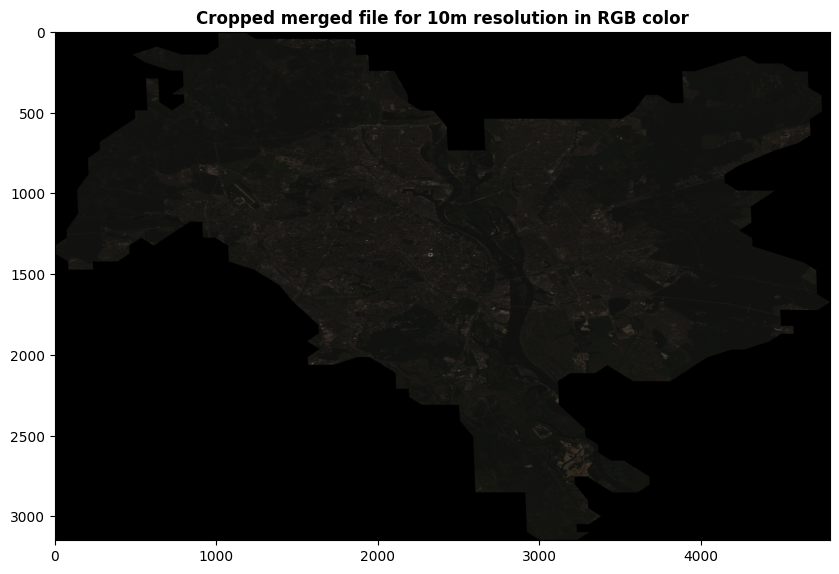

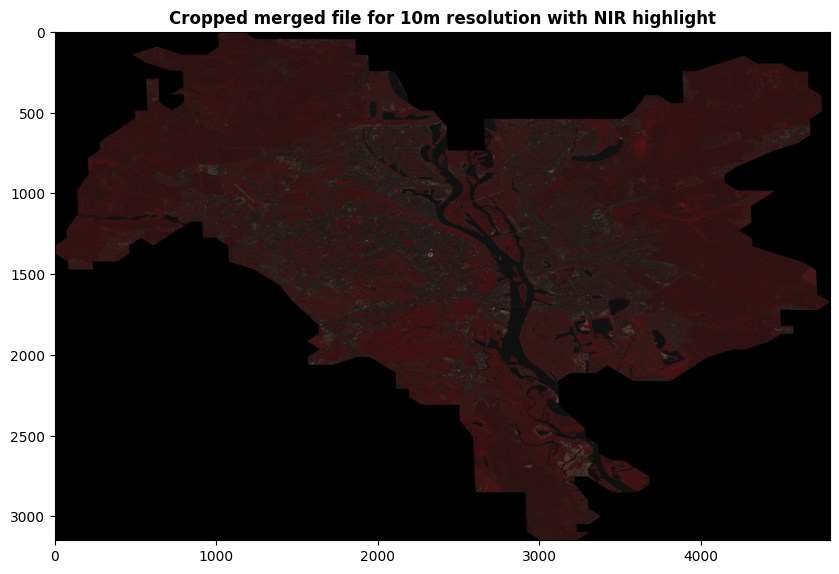

Cropping merged raster for 20m resolution...
Successfuly cropped using gdalwarp


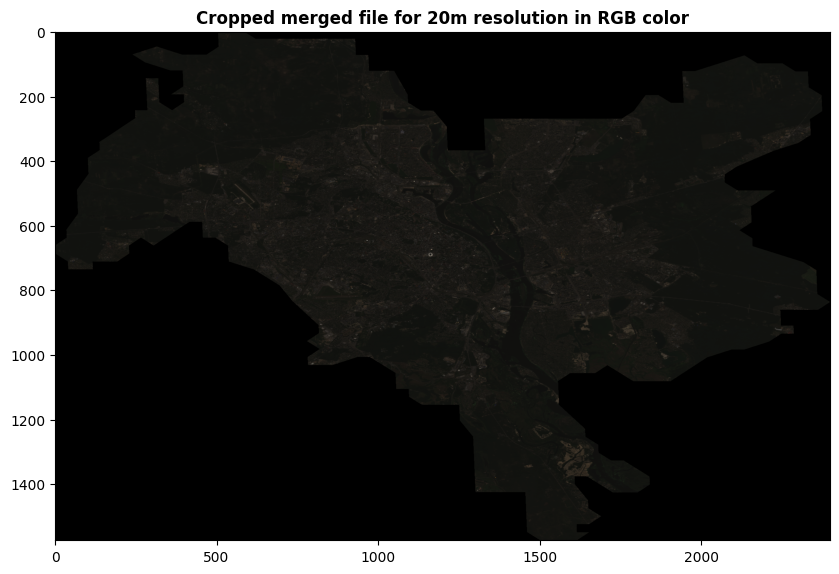

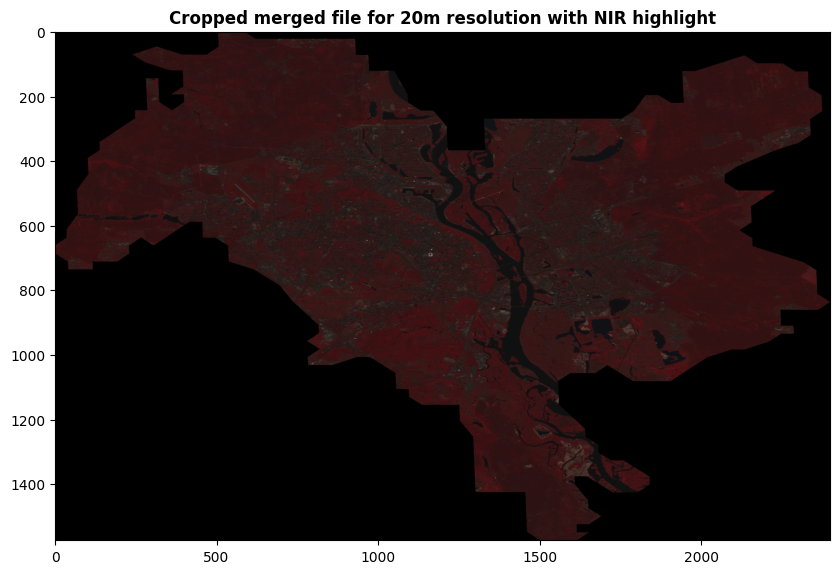

Cropping merged raster for 60m resolution...
Successfuly cropped using gdalwarp


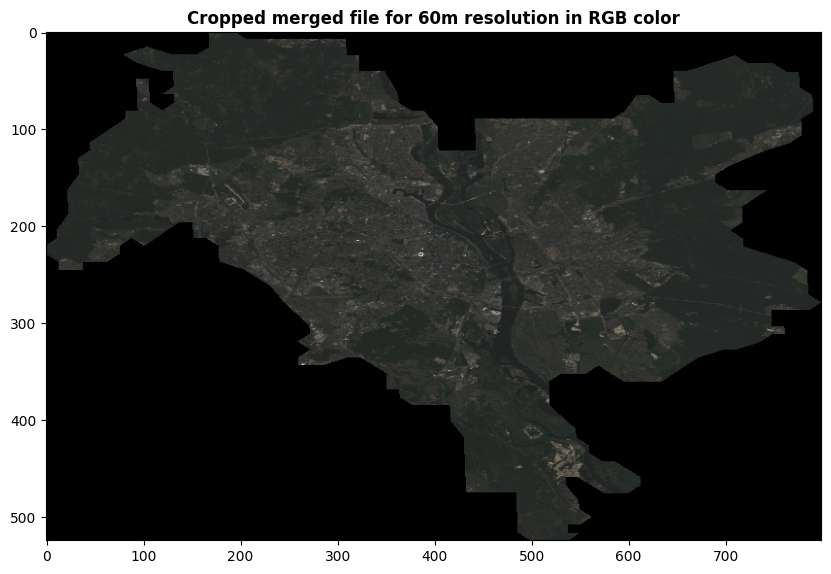

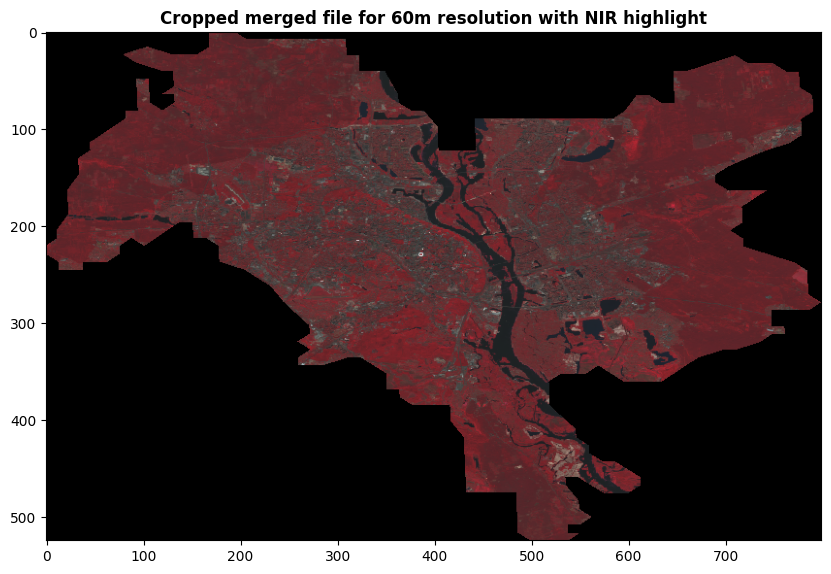

In [ ]:
for res in resolution_bands:
    print(f"Cropping merged raster for {res} resolution...")
    output_file = os.path.join(results_dir, f"cropped_res_{res}.TIF")
    result = cut_raster(shape_path, os.path.join(results_dir, f"merged_res_{res}.TIF"), output_file)
    if result:
        print("Successfuly cropped using gdalwarp")
        display_tif(output_file, f"Cropped merged file for {res} resolution")